<a href="https://colab.research.google.com/github/apgstocks/CaseStudy/blob/main/Scaler_casestudy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Problem Statement

Scaler is an online tech-versity offering intensive computer science & Data Science courses through live classes delivered by tech leaders and subject matter experts. The meticulously structured program enhances the skills of software professionals by offering a modern curriculum with exposure to the latest technologies. It is a product by InterviewBit.

You are working as a data scientist with the analytics vertical of Scaler, focused on profiling the best companies and job positions to work for from the Scaler database. You are provided with the information for a segment of learners and tasked to cluster them on the basis of their job profile, company, and other features. Ideally, these clusters should have similar characteristics.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
from sklearn.impute import KNNImputer
from datetime import date

In [ ]:
df=pd.read_csv(r"G:\Case\DataSet\scaler_clustering.csv")

In [ ]:
#Getting info on dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205843 entries, 0 to 205842
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        205843 non-null  int64  
 1   company_hash      205799 non-null  object 
 2   email_hash        205843 non-null  object 
 3   orgyear           205757 non-null  float64
 4   ctc               205843 non-null  int64  
 5   job_position      153281 non-null  object 
 6   ctc_updated_year  205843 non-null  float64
dtypes: float64(2), int64(2), object(3)
memory usage: 11.0+ MB


In [ ]:
#chek or null values
df.isnull().sum()

Unnamed: 0              0
company_hash           44
email_hash              0
orgyear                86
ctc                     0
job_position        52562
ctc_updated_year        0
dtype: int64

There are null values present in company,orgyear,job position columns

In [ ]:
#Check for unique values
for i in df.columns:
    print(f'{i} has {df[i].nunique()} unique values',i)

Unnamed: 0 has 205843 unique values Unnamed: 0
company_hash has 37299 unique values company_hash
email_hash has 153443 unique values email_hash
orgyear has 77 unique values orgyear
ctc has 3360 unique values ctc
job_position has 1017 unique values job_position
ctc_updated_year has 7 unique values ctc_updated_year


In [ ]:
#Dropping email hash as it wont be useful
df.drop(columns='email_hash',inplace=True)

In [ ]:
df.shape

(205843, 6)

There are totally 205843 rows

#### Data preprocessing

In [ ]:
def sub_process(stri):
    s=re.sub('[^A-Za-z0-9]+','',stri).lower().strip()
    return s

In [ ]:
def sub_process_job(stri):
    s=re.sub('^[Others]+','Others',stri)
    s=re.sub('[A-Za-z]*Others[a-z]*','Others',s)
    return s

In [ ]:
df['job_position'].apply(lambda z:sub_process_job(str(z)))

0                     Others
1         FullStack Engineer
2           Backend Engineer
3           Backend Engineer
4         FullStack Engineer
                 ...        
205838                   nan
205839                   nan
205840                   nan
205841                   nan
205842                   nan
Name: job_position, Length: 205843, dtype: object

In [ ]:
df.loc[df['job_position']=='']

,Unnamed: 0,company_hash,orgyear,ctc,job_position,ctc_updated_year


In [ ]:
print('column:Job position')
print('Before pre-processing',df['job_position'].nunique())
df['job_position']=df['job_position'].apply(lambda z:sub_process(str(z)))
df.replace(to_replace=['7','737','x','trOtherser','worker','zomato','trOtherssOtherstOthersrOtherssOthersestOtherstOthersr','tsOthers','91','896651','857628'],value='Others',inplace=True)
df['job_position']=df['job_position'].apply(lambda z:sub_process_job(str(z)))
df.drop_duplicates(keep='last',inplace=True)
print('After pre-processing',df['job_position'].nunique())

column:Job position
Before pre-processing 1017
After pre-processing 481


In [ ]:
print('column:Company Hash')
print('Before pre-processing',df['company_hash'].nunique())
df['company_hash']=df['company_hash'].apply(lambda z:sub_process(str(z)))
df.drop_duplicates(keep='last',inplace=True)
print('After pre-processing',df['company_hash'].nunique())

column:Company Hash
Before pre-processing 37299
After pre-processing 36585


In [ ]:
df.isnull().sum()

Unnamed: 0           0
company_hash         0
orgyear             86
ctc                  0
job_position         0
ctc_updated_year     0
dtype: int64

All the columsn except orgyear has been cleaned

#### KNN mean imputation

In [ ]:
X=df.select_dtypes(np.number)
imputer = KNNImputer(n_neighbors=2, weights='uniform', metric='nan_euclidean')
df_filled=pd.DataFrame(imputer.fit_transform(X),columns=X.columns)
df_filled

,Unnamed: 0,orgyear,ctc,ctc_updated_year
0,0.0,2016.0,1100000.0,2020.0
1,1.0,2018.0,449999.0,2019.0
2,2.0,2015.0,2000000.0,2020.0
3,3.0,2017.0,700000.0,2019.0
4,4.0,2017.0,1400000.0,2019.0
...,...,...,...,...
205838,206918.0,2008.0,220000.0,2019.0
205839,206919.0,2017.0,500000.0,2020.0
205840,206920.0,2021.0,700000.0,2021.0
205841,206921.0,2019.0,5100000.0,2019.0


In [ ]:
df=df.merge(df_filled,on='Unnamed: 0',how='left')

In [ ]:
df

,Unnamed: 0,company_hash,orgyear_x,ctc_x,job_position,ctc_updated_year_x,orgyear_y,ctc_y,ctc_updated_year_y
0,0,atrgxnntxzaxv,2016.0,1100000,other,2020.0,2016.0,1100000.0,2020.0
1,1,qtrxvzwtxzegwgbbrxbxnta,2018.0,449999,fullstackengineer,2019.0,2018.0,449999.0,2019.0
2,2,ojzwnvwnxwvx,2015.0,2000000,backendengineer,2020.0,2015.0,2000000.0,2020.0
3,3,ngpgutaxv,2017.0,700000,backendengineer,2019.0,2017.0,700000.0,2019.0
4,4,qxensqghu,2017.0,1400000,fullstackengineer,2019.0,2017.0,1400000.0,2019.0
...,...,...,...,...,...,...,...,...,...
205838,206918,vuurtxzw,2008.0,220000,nan,2019.0,2008.0,220000.0,2019.0
205839,206919,husqvawgb,2017.0,500000,nan,2020.0,2017.0,500000.0,2020.0
205840,206920,vwwgrxnt,2021.0,700000,nan,2021.0,2021.0,700000.0,2021.0
205841,206921,zgnvuurxwvmrt,2019.0,5100000,nan,2019.0,2019.0,5100000.0,2019.0


In [ ]:
df.columns

Index(['Unnamed: 0', 'company_hash', 'orgyear_x', 'ctc_x', 'job_position',
       'ctc_updated_year_x', 'orgyear_y', 'ctc_y', 'ctc_updated_year_y'],
      dtype='object')

In [ ]:
df=df.drop(columns=['Unnamed: 0','orgyear_x','ctc_x','ctc_updated_year_x'])

In [ ]:
df.rename(columns={'orgyear_y':'orgyear','ctc_y':'ctc','ctc_updated_year_y':'ctc_updated_year'},inplace=True)

In [ ]:
df.drop_duplicates(keep='last',inplace=True)

In [ ]:
df.isnull().sum()

company_hash        0
job_position        0
orgyear             0
ctc                 0
ctc_updated_year    0
dtype: int64

Still,there are few null values in org year.Dropping it

### Outlier Detection

In [ ]:
#Removing outliers using IQR
def outlier(df,col):
    print(col)
    q1=df[col].quantile(0.25)
    q3=df[col].quantile(0.75)
    iqr=q3-q1
    df=df.loc[(df[col]>=q1-1.5*iqr) & (df[col]<=q3+1.5*iqr)]
    return df

In [ ]:
df.head()

,company_hash,job_position,orgyear,ctc,ctc_updated_year
0,atrgxnntxzaxv,other,2016.0,1100000.0,2020.0
1,qtrxvzwtxzegwgbbrxbxnta,fullstackengineer,2018.0,449999.0,2019.0
2,ojzwnvwnxwvx,backendengineer,2015.0,2000000.0,2020.0
3,ngpgutaxv,backendengineer,2017.0,700000.0,2019.0
4,qxensqghu,fullstackengineer,2017.0,1400000.0,2019.0


In [ ]:
df.dtypes

company_hash         object
job_position         object
orgyear             float64
ctc                 float64
ctc_updated_year    float64
dtype: object

In [ ]:
for i in ('orgyear','ctc'):

    df=outlier(df,i)

orgyear
ctc


In [ ]:
df.shape

(168657, 5)

In [ ]:
df.job_position.sort_values

<bound method Series.sort_values of 0                     other
1         fullstackengineer
2           backendengineer
3           backendengineer
4         fullstackengineer
                ...        
205837                  nan
205838                  nan
205839                  nan
205840                  nan
205842                  nan
Name: job_position, Length: 168657, dtype: object>

In [ ]:
#As we are seeing some nan in job position,repalcing them with Nan
df.loc[df['job_position']=='nan', 'job_position']=np.nan

In [ ]:
df['job_position'].value_counts()

backendengineer               36450
fullstackengineer             22385
Others                        15431
other                         14764
frontendengineer               9433
                              ...  
webcenterconsultant               1
popengineer                       1
associatetechnicalengineer        1
messengercomedriver               1
azuredatafactory                  1
Name: job_position, Length: 435, dtype: int64

In [ ]:
df_numerical=df.select_dtypes(np.number)
print('***numerical columns***')
print(df_numerical.columns)
print('***categorical columns***')
print(df.select_dtypes('object').columns)

***numerical columns***
Index(['orgyear', 'ctc', 'ctc_updated_year'], dtype='object')
***categorical columns***
Index(['company_hash', 'job_position'], dtype='object')


### Data Visualisation

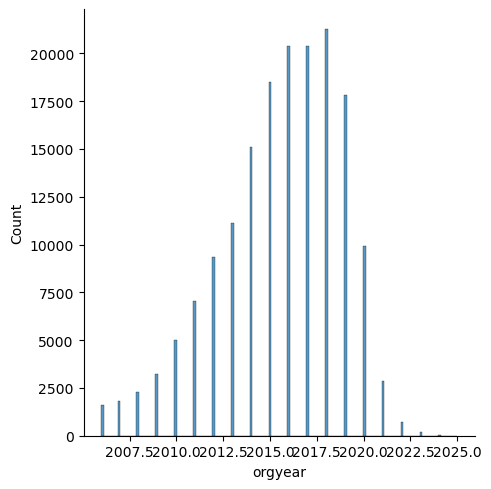

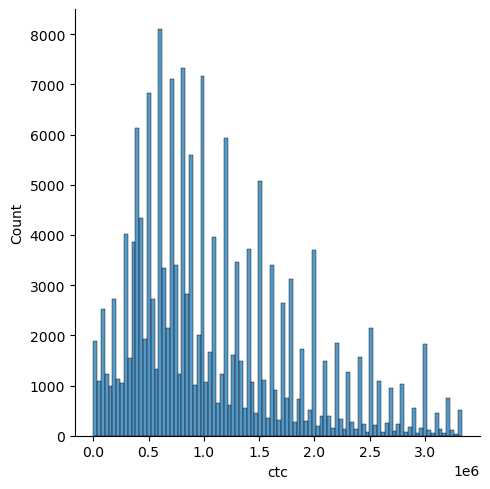

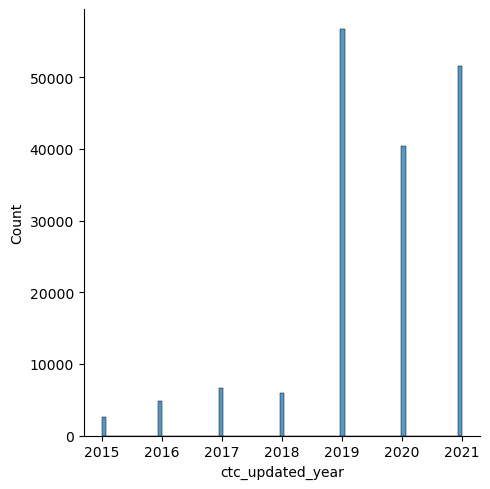

In [ ]:
#visualise(df,i)
for i in df_numerical.columns:
    #fig,axes=plt.subplots(figsize=(10,6))
    sns.displot(df[i])
    plt.show()

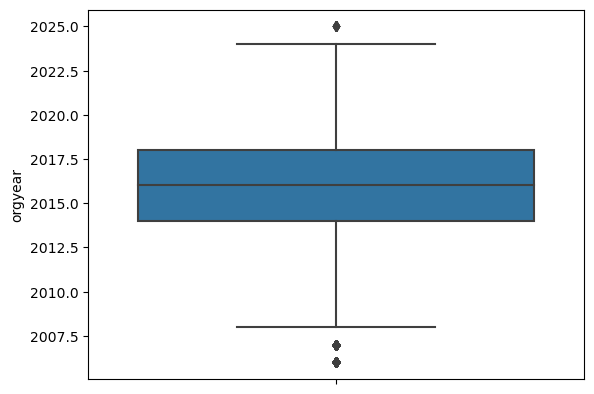

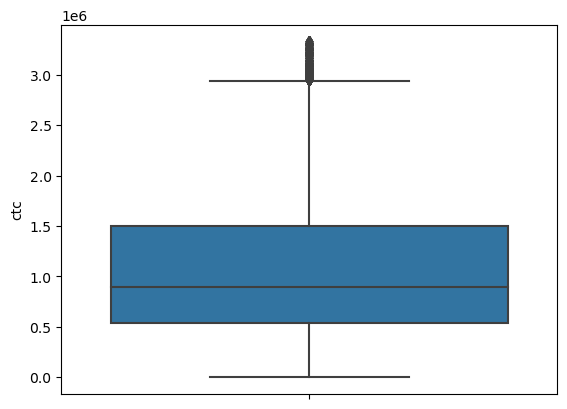

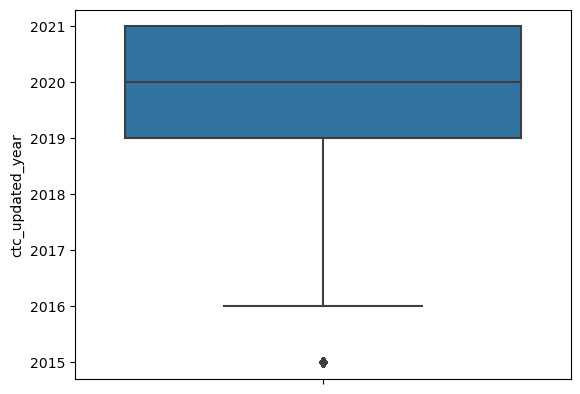

In [ ]:
for i in df_numerical.columns:
    sns.boxplot(y=df[i])
    plt.show()

### Feature Engineering

In [ ]:
#Adding year of experience column
todays_date = date.today()

df['experience']=todays_date.year-df['orgyear'].astype('int')

In [ ]:
df.company_hash.value_counts()


nvnvwgzohrnvzwjotqcxwto           4015
xzegojo                           2865
vbvkgz                            2212
wgszxkvzn                         2100
vwwtznhqt                         1987
                                  ... 
vuurxtaxzegotqcxwtoxzaxvucnrna       1
zxztrtvuontwyzgrgsjogrhnxgzo         1
ntpurvjojontbrna                     1
mvphov                               1
wyvqntqwgbbhzxwvnxgzo                1
Name: company_hash, Length: 33478, dtype: int64

In [ ]:
df.company_hash.value_counts()<5

nvnvwgzohrnvzwjotqcxwto           False
xzegojo                           False
vbvkgz                            False
wgszxkvzn                         False
vwwtznhqt                         False
                                  ...  
vuurxtaxzegotqcxwtoxzaxvucnrna     True
zxztrtvuontwyzgrgsjogrhnxgzo       True
ntpurvjojontbrna                   True
mvphov                             True
wyvqntqwgbbhzxwvnxgzo              True
Name: company_hash, Length: 33478, dtype: bool

In [ ]:
df['job_position'] = df['job_position'].astype('object').fillna('Others')
df['company_hash'] = df['company_hash'].astype('object').fillna('Others')

In [ ]:
df.loc[df.groupby('company_hash')['ctc'].transform('count') < 5, 'company_hash'] = 'Others'

In [ ]:
df.isnull().sum()

company_hash        0
job_position        0
orgyear             0
ctc                 0
ctc_updated_year    0
experience          0
dtype: int64

In [ ]:
df.drop_duplicates(inplace=True)
df.shape

(144610, 6)

#### Manual clustering based on experience,job_position and company

In [ ]:
df1=df.groupby(['experience','job_position','company_hash'])['ctc'].describe()

In [ ]:
df=df.merge(df1,on=['experience','job_position','company_hash'],how='left')

In [ ]:
def flag_exp_job_company(a,b,c):
    if a<b:
        return 3
    elif a>=b and a<c:
        return 2
    else:
        return 1

In [ ]:
df.columns

Index(['company_hash', 'job_position', 'orgyear', 'ctc', 'ctc_updated_year',
       'experience', 'count', 'mean', 'std', 'min', '25%', '50%', '75%',
       'max'],
      dtype='object')

In [ ]:
df['designation']=df.apply(lambda x:flag_exp_job_company(x['ctc'],x['50%'],x['75%']),axis=1)

In [ ]:
df['designation'].value_counts()

1    71167
3    50232
2    23211
Name: designation, dtype: int64

In [ ]:
df.columns

Index(['company_hash', 'job_position', 'orgyear', 'ctc', 'ctc_updated_year',
       'experience', 'count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max',
       'designation'],
      dtype='object')

In [ ]:
df.drop(['count','mean','std','min','25%','50%','75%','max'],axis=1,inplace=True)

#### Manual clustering based on job position and company

In [ ]:
df2=df.groupby(['job_position','company_hash'])['ctc'].describe()

In [ ]:
df2

count          mean  \
job_position               company_hash                                 
                           Others                   1.0  7.000000e+05   
                           otretburgjta             1.0  6.000000e+05   
Others                     1bs                     23.0  1.389130e+06   
                           1bsntwyzgrgsxtoucnrna   10.0  1.280000e+06   
                           1onaxmo                  4.0  1.842500e+06   
...                                                 ...           ...   
webdesignerdeveloperintern nytouvqpoeghzavnxgz      1.0  4.200000e+05   
webdeveloperfullstack      vzgnytqwgbuvzj           1.0  3.000000e+05   
webuidesigner              vrgyvntwyzgrgsj          1.0  1.019999e+06   
wordpressdeveloper         Others                   1.0  6.000000e+05   
youngprofessionalii        sgctqzbtzngexzaxv        1.0  5.000000e+05   

                                                            std        min  \
job_position               company_hash                                      
                           Others                           NaN   700000.0   
                           otretburgjta                     NaN   600000.0   
Others                     1bs                    611249.934326   600000.0   
                           1bsntwyzgrgsxtoucnrna  743564.986325   100000.0   
                           1onaxmo                388876.587107  1500000.0   
...                                                         ...        ...   
webdesignerdeveloperintern nytouvqpoeghzavnxgz              NaN   420000.0   
webdeveloperfullstack      vzgnytqwgbuvzj                   NaN   300000.0   
webuidesigner              vrgyvntwyzgrgsj                  NaN  1019999.0   
wordpressdeveloper         Others                           NaN   600000.0   
youngprofessionalii        sgctqzbtzngexzaxv                NaN   500000.0   

                                                        25%        50%  \
job_position               company_hash                                  
                           Others                  700000.0   700000.0   
                           otretburgjta            600000.0   600000.0   
Others                     1bs                     950000.0  1350000.0   
                           1bsntwyzgrgsxtoucnrna  1000000.0  1100000.0   
                           1onaxmo                1650000.0  1735000.0   
...                                                     ...        ...   
webdesignerdeveloperintern nytouvqpoeghzavnxgz     420000.0   420000.0   
webdeveloperfullstack      vzgnytqwgbuvzj          300000.0   300000.0   
webuidesigner              vrgyvntwyzgrgsj        1019999.0  1019999.0   
wordpressdeveloper         Others                  600000.0   600000.0   
youngprofessionalii        sgctqzbtzngexzaxv       500000.0   500000.0   

                                                        75%        max  
job_position               company_hash                                 
                           Others                  700000.0   700000.0  
                           otretburgjta            600000.0   600000.0  
Others                     1bs                    1600000.0  3300000.0  
                           1bsntwyzgrgsxtoucnrna  1425000.0  2700000.0  
                           1onaxmo                1927500.0  2400000.0  
...                                                     ...        ...  
webdesignerdeveloperintern nytouvqpoeghzavnxgz     420000.0   420000.0  
webdeveloperfullstack      vzgnytqwgbuvzj          300000.0   300000.0  
webuidesigner              vrgyvntwyzgrgsj        1019999.0  1019999.0  
wordpressdeveloper         Others                  600000.0   600000.0  
youngprofessionalii        sgctqzbtzngexzaxv       500000.0   500000.0  

[19774 rows x 8 columns]

In [ ]:
df=df.merge(df2,on=['job_position','company_hash'],how='left')

In [ ]:
df

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,count,mean,std,min,25%,50%,75%,max
0,atrgxnntxzaxv,other,2016.0,1100000.0,2020.0,7,1,2.0,1.085000e+06,2.121320e+04,1070000.0,1077500.0,1085000.0,1092500.0,1100000.0
1,qtrxvzwtxzegwgbbrxbxnta,fullstackengineer,2018.0,449999.0,2019.0,5,3,25.0,9.882000e+05,4.874998e+05,300000.0,600000.0,850000.0,1380000.0,2000000.0
2,ojzwnvwnxwvx,backendengineer,2015.0,2000000.0,2020.0,8,1,3.0,1.983333e+06,5.251984e+05,1450000.0,1725000.0,2000000.0,2250000.0,2500000.0
3,ngpgutaxv,backendengineer,2017.0,700000.0,2019.0,6,3,24.0,1.416667e+06,5.453413e+05,520000.0,1047500.0,1375000.0,1792500.0,2600000.0
4,qxensqghu,fullstackengineer,2017.0,1400000.0,2019.0,6,1,3.0,8.466667e+05,4.801389e+05,540000.0,570000.0,600000.0,1000000.0,1400000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144605,zgnvuurxwvmrt,Others,2021.0,800000.0,2021.0,2,3,590.0,9.629799e+05,8.093506e+05,7300.0,342500.0,700000.0,1400000.0,3300000.0
144606,vuurtxzw,Others,2008.0,220000.0,2019.0,15,1,16.0,1.568312e+06,1.231984e+06,60000.0,216250.0,2275000.0,2550000.0,3000000.0
144607,husqvawgb,Others,2017.0,500000.0,2020.0,6,3,23.0,1.384348e+06,6.741110e+05,500000.0,975000.0,1200000.0,1615000.0,3200000.0
144608,vwwgrxnt,Others,2021.0,700000.0,2021.0,2,2,45.0,1.372289e+06,6.897825e+05,300000.0,900000.0,1200000.0,1500000.0,2900000.0


In [ ]:
df['class']=df.apply(lambda x:flag_exp_job_company(x['ctc'],x['50%'],x['75%']),axis=1)

In [ ]:
df.columns

Index(['company_hash', 'job_position', 'orgyear', 'ctc', 'ctc_updated_year',
       'experience', 'designation', 'count', 'mean', 'std', 'min', '25%',
       '50%', '75%', 'max', 'class'],
      dtype='object')

In [ ]:
df.drop(['count','mean','std','min','25%','50%','75%','max'],axis=1,inplace=True)

In [ ]:
df.shape

(144610, 8)

#### Manual clustering with company name and CTC

In [ ]:
df3=df.groupby('company_hash')['ctc'].describe()
df=df.merge(df3,on='company_hash',how='left')
df['tier']=df.apply(lambda x:flag_exp_job_company(x['ctc'],x['50%'],x['75%']),axis=1)

In [ ]:
df.drop(['count','mean','std','min','25%','50%','75%','max'],axis=1,inplace=True)

In [ ]:
df

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
0,atrgxnntxzaxv,other,2016.0,1100000.0,2020.0,7,1,1,2
1,qtrxvzwtxzegwgbbrxbxnta,fullstackengineer,2018.0,449999.0,2019.0,5,3,3,3
2,ojzwnvwnxwvx,backendengineer,2015.0,2000000.0,2020.0,8,1,2,2
3,ngpgutaxv,backendengineer,2017.0,700000.0,2019.0,6,3,3,3
4,qxensqghu,fullstackengineer,2017.0,1400000.0,2019.0,6,1,1,1
...,...,...,...,...,...,...,...,...,...
144605,zgnvuurxwvmrt,Others,2021.0,800000.0,2021.0,2,3,2,2
144606,vuurtxzw,Others,2008.0,220000.0,2019.0,15,1,3,3
144607,husqvawgb,Others,2017.0,500000.0,2020.0,6,3,3,3
144608,vwwgrxnt,Others,2021.0,700000.0,2021.0,2,2,3,3


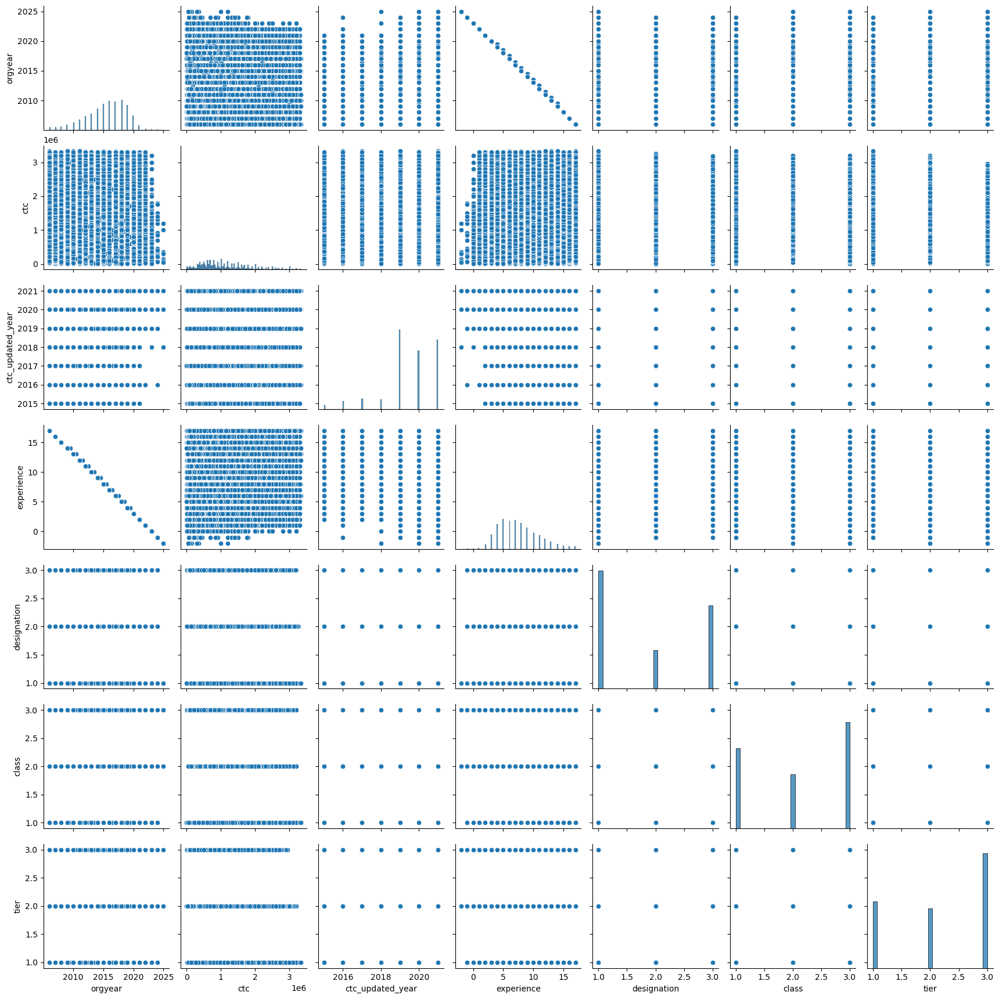

In [ ]:
sns.pairplot(df)
plt.show()


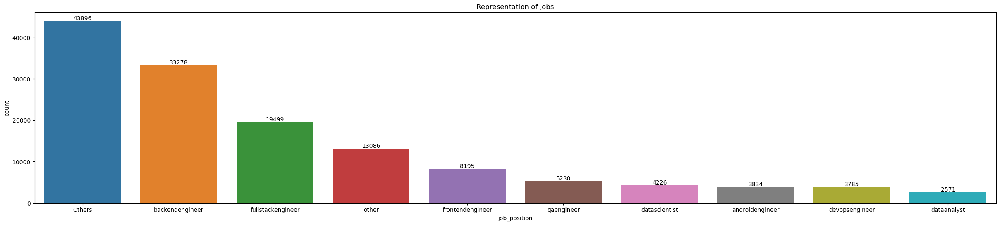

In [ ]:
plt.figure(figsize=(30,6))
ax = sns.countplot(data = df, x = 'job_position', order = df['job_position'].value_counts().index[:10], linewidth=0.5)
ax.bar_label(ax.containers[0])
plt.title('Representation of jobs')
plt.show()

Observation:
    From the above data,it is evident that there could be three clusters (between experience and class/designation/tier)
    
    The top 10 job position of students are backend engineer,fullstack engineer,frontend engineer,qaengineer,data scientist,android engineer,devops engineer and data analyst

<Figure size 3000x600 with 0 Axes>

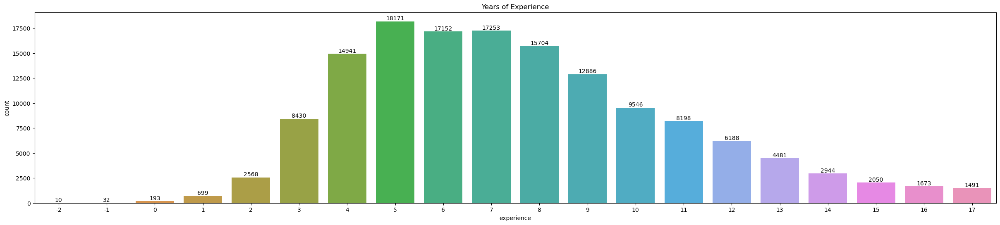

In [ ]:
plt.figure(figsize=(30,6))
ax = sns.countplot(data = df, x = 'experience',
              order = sorted(df['experience'].value_counts().index), linewidth=0.5)
ax.bar_label(ax.containers[0])
plt.title('Years of Experience')
plt.show()

<Figure size 3000x600 with 0 Axes>

<Figure size 3000x600 with 0 Axes>

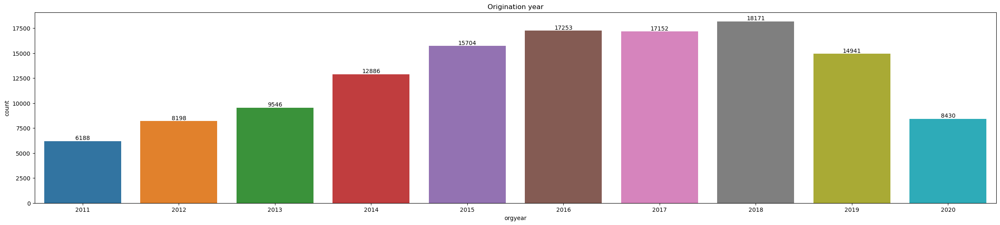

In [ ]:
df['orgyear']=df['orgyear'].astype('int')
plt.figure(figsize=(30,6))
ax = sns.countplot(data = df, x = 'orgyear',
              order = sorted(df['orgyear'].value_counts()[:10].index), linewidth=0.5)
ax.bar_label(ax.containers[0])
plt.title('Origination year')
plt.show()

G:\software\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



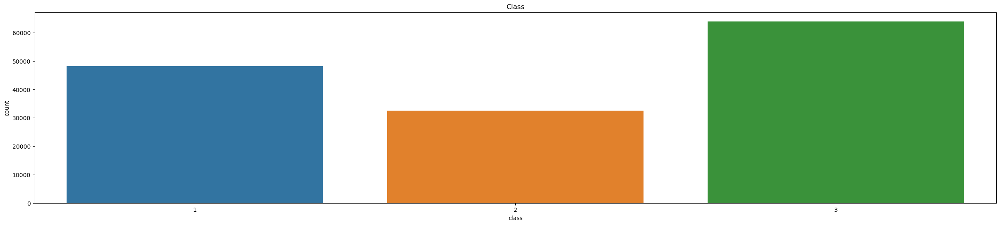

In [ ]:
plt.figure(figsize=(30,6))
sns.countplot(df['class'])
plt.title('Class')
plt.show()

G:\software\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



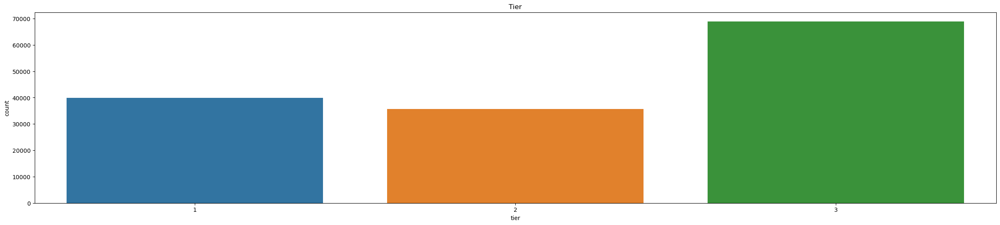

In [ ]:
plt.figure(figsize=(30,6))
sns.countplot(df['tier'])
plt.title('Tier')
plt.show()

G:\software\lib\site-packages\seaborn\_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



<Figure size 3000x600 with 0 Axes>

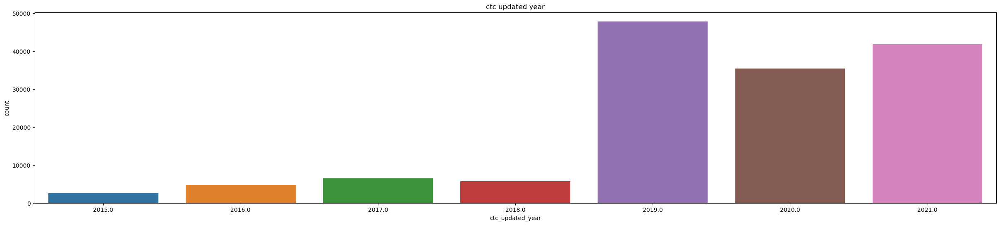

In [ ]:
plt.figure(figsize=(30,6))
sns.countplot(df['ctc_updated_year'])
plt.title('ctc updated year')
plt.show()

Observation:

Most people have  5 years of experience on an average

Most people have 2018 as their origination year

Class 3 and tier 3 have high count

CTC updated year was highest in 2018



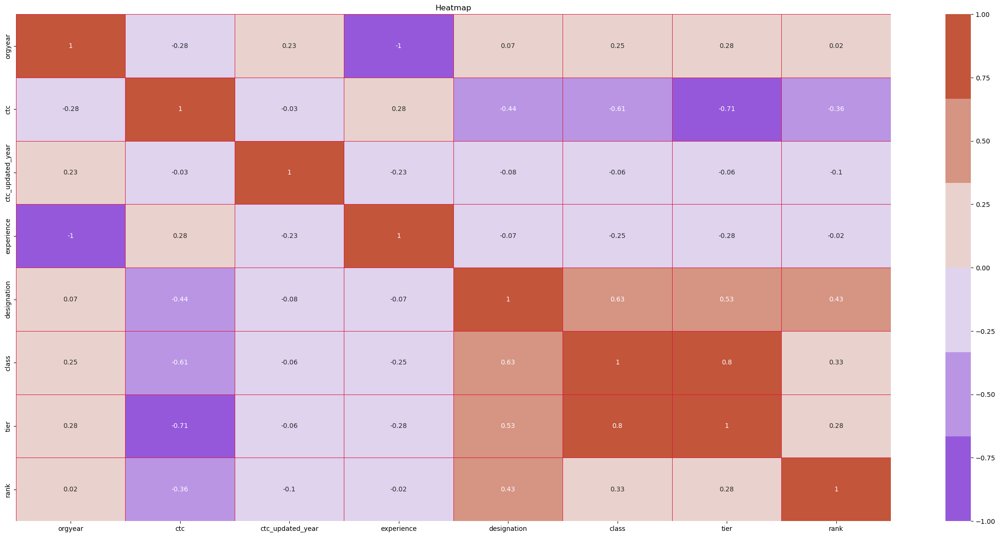

In [ ]:
df_corr = df.corr()
plt.figure(figsize=(30,14))
cmap = sns.diverging_palette(280, 20)
plt.title('Heatmap')
sns.heatmap(np.round(df_corr,2), annot=True, linewidths=.6, linecolor='crimson', cmap=cmap)
plt.show()

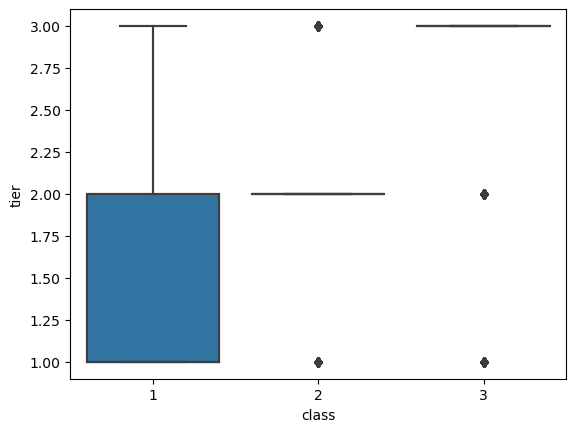

In [ ]:
sns.boxplot(data=df,x='class',y='tier')
plt.show()

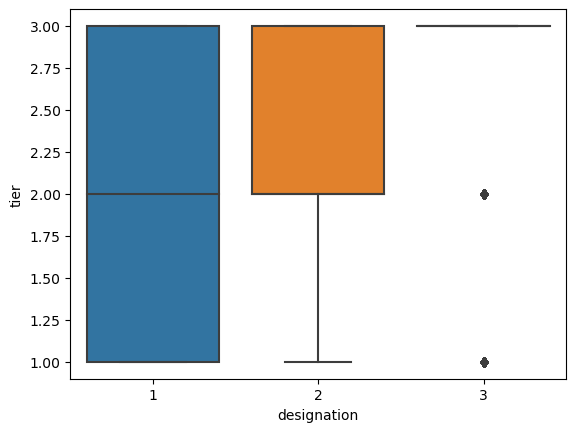

In [ ]:
sns.boxplot(data=df,x='designation',y='tier')
plt.show()

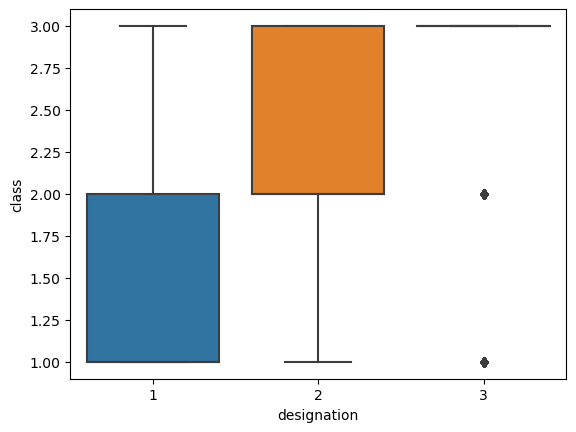

In [ ]:
sns.boxplot(data=df,x='designation',y='class')
plt.show()

Observation:
    Tier and class have high correlation

### Answering questions

In [ ]:
df.loc[df.job_position=='dataanalyst']

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
9,wgszxkvzn,dataanalyst,2016.0,440000.0,2020.0,7,2,3,3
92,mxkvwhxnjogrhnxgzo,dataanalyst,2019.0,700000.0,2019.0,4,1,3,3
131,zgnvuurxwvmrtvwwghzn,dataanalyst,2013.0,440000.0,2019.0,10,1,3,3
153,ogwxnszqvrt,dataanalyst,2017.0,460000.0,2019.0,6,1,3,3
176,zgcvqnxo,dataanalyst,2018.0,800000.0,2020.0,5,1,3,3
...,...,...,...,...,...,...,...,...,...
143999,hmtq,dataanalyst,2020.0,2400000.0,2021.0,3,1,1,2
144016,wgszxkvzn,dataanalyst,2020.0,420000.0,2021.0,3,2,3,3
144045,rgftoxzaxv,dataanalyst,2012.0,891000.0,2021.0,11,1,1,3
144063,zgnvuurxwvmrtvwwghzn,dataanalyst,2022.0,1300000.0,2021.0,1,3,1,1


In [ ]:
#Top 10 data science roles in tier 1 companies
df[df.job_position.str.contains('^data') & (df.tier==1) & (df['class']==1)].sort_values(by='ctc',ascending=False)[:10]

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
141682,Others,datascientist,2015.0,3310000.0,2020.0,8,1,1,1
38332,fzosrgmvrotqcxwto,datascientist,2010.0,3300000.0,2019.0,13,1,1,1
92446,st,datascientist,2008.0,3300000.0,2018.0,15,1,1,1
120338,sgrabvzovwyo,dataanalyst,2018.0,3300000.0,2019.0,5,1,1,1
85911,stytvrnywvqt,datascientist,2013.0,3300000.0,2020.0,10,1,1,1
78617,wxnx,datascientist,2006.0,3300000.0,2021.0,17,1,1,1
135301,bxrrxbvz,datascientist,2019.0,3300000.0,2019.0,4,1,1,1
72047,ofxssj,datascientist,2013.0,3300000.0,2019.0,10,1,1,1
10259,bxwqgogen,datascientist,2019.0,3300000.0,2021.0,4,1,1,1
62380,bxwqgogen,datascientist,2013.0,3300000.0,2020.0,10,1,1,1


In [ ]:
#Bottom 10 data science role ctc in tier 1 companies but class 3
df[df.job_position.str.contains('^data') & (df.tier==1) & (df['class']==3)].sort_values(by='ctc',ascending=True)[:10]

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
19868,vbtqxwvztduqtoosmn,dataanalyst,2017.0,300000.0,2020.0,6,3,3,1
8672,nytouvqpoeghzavnxgz,datascientist,2018.0,600000.0,2021.0,5,1,3,1
119042,xvbeqtoytq,datascientist,2019.0,700000.0,2018.0,4,3,3,1
72040,zvnxgzvruvjbtznowgqugqvnxgzgexzaxv,datascientist,2016.0,740000.0,2019.0,7,1,3,1
30212,ztfstzogenfvqt,datascientist,2019.0,780000.0,2020.0,4,3,3,1
95939,ztfstzogenfvqt,datascientist,2018.0,800000.0,2019.0,5,1,3,1
13686,zthatoxw,datascientist,2016.0,800000.0,2020.0,7,1,3,1
118599,pcvznhbxzw,datascientist,2016.0,800000.0,2017.0,7,1,3,1
99750,whmvonxgzwgzohrnxzsucnrna,dataanalyst,2017.0,880000.0,2019.0,6,1,3,1
7030,ntrtutqegqbvzwt,datascientist,2016.0,900000.0,2020.0,7,1,3,1


In [ ]:
#Bottom 10 employees in tier 3
df[df['tier']==3].sort_values(by='ctc',ascending=True)

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
93808,xzntqcxtfmxn,backendengineer,2014.0,2.0,2019.0,9,3,3,3
81617,xzntqcxtfmxn,Others,2013.0,6.0,2018.0,10,3,3,3
78668,xzntqcxtfmxn,Others,2013.0,14.0,2018.0,10,2,3,3
129321,Others,Others,2016.0,15.0,2018.0,7,3,3,3
128452,Others,Others,2019.0,16.0,2018.0,4,3,3,3
...,...,...,...,...,...,...,...,...,...
121069,wrhbxg,backendengineer,2018.0,2700000.0,2021.0,5,1,3,3
101041,yvqztooxg,backendengineer,2017.0,2750000.0,2020.0,6,3,3,3
90021,wrhonq,backendengineer,2013.0,2790000.0,2019.0,10,1,3,3
31230,gmotqctvxk21rvmo,Others,2019.0,2900000.0,2019.0,4,1,2,3


In [ ]:
#Top 10 employees in Amazon- X department - having 5/6/7 years of experience earning more than their peers - Tier X
df[df.experience.isin([5,6,7])].sort_values(by = ['ctc'], ascending = False)[:10]

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier
92378,bxwqgogenqtotvqwyxzaxv,Others,2017.0,3330000.0,2021.0,6,1,1,1
127416,wgrgqngptzorruxzaxvucnrna,frontendengineer,2017.0,3325000.0,2021.0,6,1,1,1
64241,sgrabvzovwyo,backendengineer,2017.0,3320000.0,2021.0,6,1,1,1
122667,vbvkgz,fullstackengineer,2017.0,3305000.0,2019.0,6,1,1,1
138658,Others,fullstackengineer,2018.0,3300000.0,2020.0,5,1,1,1
91009,ojztwyqgz,Others,2017.0,3300000.0,2019.0,6,1,1,1
112730,eqtoytq,other,2018.0,3300000.0,2020.0,5,1,1,1
127945,vbvkgz,fullstackengineer,2016.0,3300000.0,2019.0,7,1,1,1
47590,vbvkgz,appliedscientistii,2017.0,3300000.0,2021.0,6,1,1,1
127834,sgrabvzovwyo,datascientist,2018.0,3300000.0,2019.0,5,1,1,1


In [ ]:
#Top 10 companies (based on their CTC)
df.sort_values('ctc',ascending=False)[:10]['company_hash']

81344               uvjovetsqghu
120066                 btaxvpxza
132851                 btaxvpxza
92378     bxwqgogenqtotvqwyxzaxv
95004             mtwpbvzwghrntq
126569                    Others
37730                   nvnvwrxi
91320                   erxupvqn
131976                    Others
45230                      uvjnb
Name: company_hash, dtype: object

In [ ]:
#Top 2 positions in every company (based on their CTC)
df['rank']=df.groupby(['company_hash','job_position'])['ctc'].rank(method='dense', ascending=False).astype(int)
df[(df['rank'] == 1) | (df['rank'] == 2)].sort_values(by = ['company_hash','job_position','ctc'], ascending = [True,True,False])

,company_hash,job_position,orgyear,ctc,ctc_updated_year,experience,designation,class,tier,rank
97593,1bs,Others,2011.0,3300000.0,2016.0,12,1,1,1,1
122815,1bs,Others,2008.0,2500000.0,2019.0,15,1,1,1,2
94604,1bs,androidengineer,2018.0,900000.0,2019.0,5,1,1,3,1
116750,1bs,androidengineer,2017.0,700000.0,2019.0,6,1,2,3,2
53898,1bs,backendengineer,2015.0,2930000.0,2019.0,8,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...
74140,zxztrtvuo,fullstackengineer,2016.0,1200000.0,2020.0,7,1,1,1,2
118654,zxztrtvuo,iosengineer,2013.0,1200000.0,2017.0,10,1,1,1,1
49045,zxztrtvuo,memberoftechnicalstaffatnineleaps,2016.0,1200000.0,2020.0,7,1,1,1,1
8016,zxztrtvuo,other,2020.0,450000.0,2020.0,3,1,1,3,1


In [ ]:
X = df[['ctc', 'experience', 'class', 'designation', 'tier']].copy()

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(X)
X_sc = pd.DataFrame(scaler.transform(X), columns=X.columns, index=X.index)

In [ ]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()
df['company_hash']= label_encoder.fit_transform(df['company_hash'])


In [ ]:
df['job_position']= label_encoder.fit_transform(df['job_position'])
len(df['job_position'].unique())

435

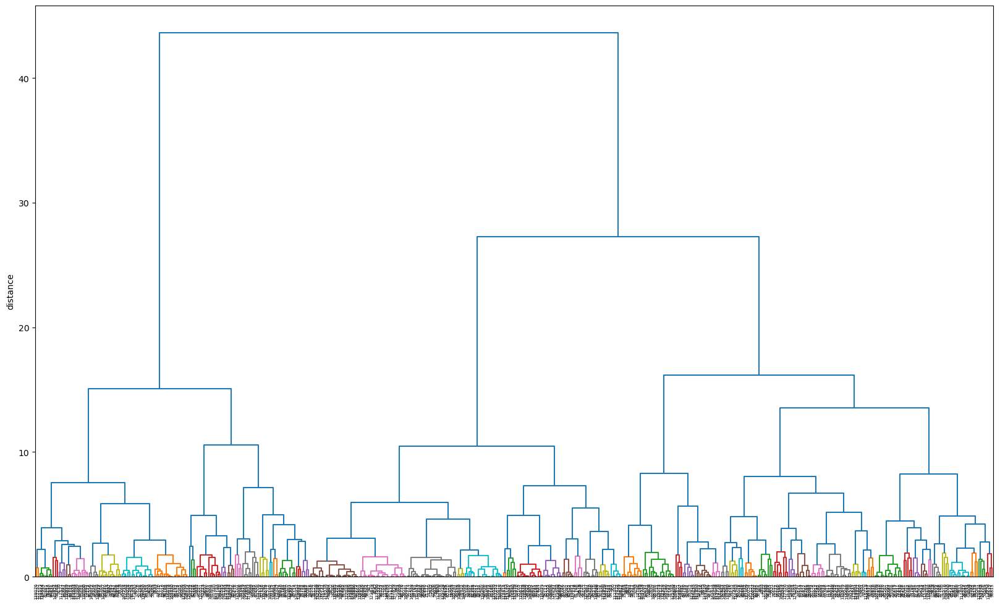

In [ ]:
import scipy.cluster.hierarchy as sch

sample = X_sc.sample(500)
Z = sch.linkage(sample, method='ward')

fig, ax = plt.subplots(figsize=(20, 12))
sch.dendrogram(Z, labels=sample.index, ax=ax, color_threshold=2)
plt.xticks(rotation=90)
ax.set_ylabel('distance')
plt.show()

Observation:From the hierarchial clustering,we could see that there are 3 clusters

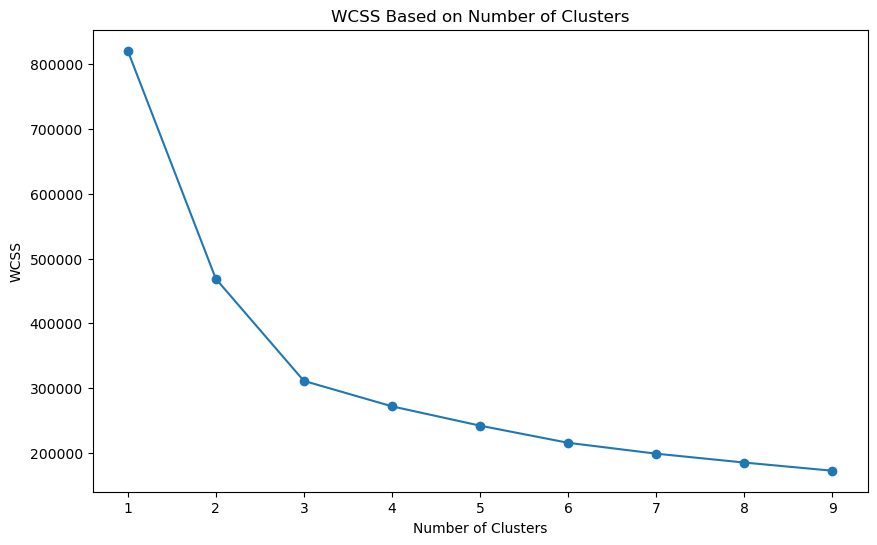

In [ ]:
#Elbow method
wcss = []
for k in range(1, 10):
    model = KMeans(n_clusters = k)
    model.fit(X_sc)
    wcss.append(model.inertia_)
fig, ax = plt.subplots(figsize=(10, 6))
plt.plot(range(1, 10), wcss, '-o')
plt.title('WCSS Based on Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

Ideal numbber of clusters we can take is 3 or 4.

In [ ]:
from sklearn.cluster import KMeans

k = 3
kmeans = KMeans(n_clusters=k, random_state=42)
y_pred = kmeans.fit_predict(X_sc)
clusters = pd.DataFrame(X_sc, columns=X.columns)
clusters['label'] = kmeans.labels_
print(clusters['label'].value_counts())

0    54175
1    46212
2    44223
Name: label, dtype: int64


In [ ]:
print(clusters.head(10))

        ctc  experience     class  designation      tier  label
0 -0.040966   -0.160943 -1.269493    -0.945290 -0.237371      2
1 -0.917095   -0.765940  1.019723     1.265317  0.947110      0
2  1.172132    0.141556 -0.124885    -0.945290 -0.237371      1
3 -0.580121   -0.463441  1.019723     1.265317  0.947110      0
4  0.363400   -0.463441 -1.269493    -0.945290 -1.421852      1
5 -0.580121   -0.765940 -1.269493    -0.945290 -0.237371      2
6 -0.984488   -1.068439  1.019723     1.265317  0.947110      0
7 -1.038403   -1.068439  1.019723     1.265317  0.947110      0
8 -0.714910   -0.160943  1.019723     1.265317  0.947110      0
9 -0.930572   -0.160943  1.019723     0.160013  0.947110      0


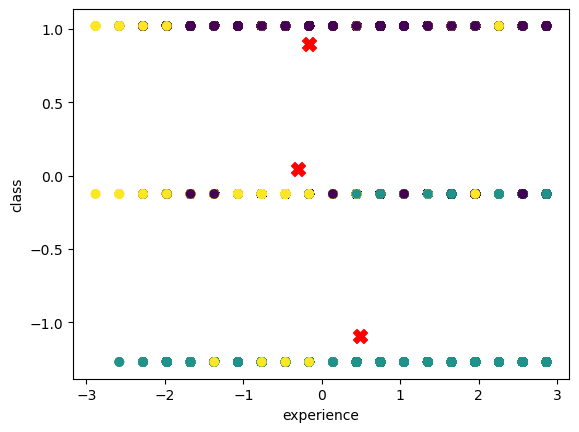

In [ ]:

plt.scatter(clusters['experience'], clusters['class'], c=clusters['label'] )
plt.scatter(kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2], color="red", marker="X",s=100)
plt.xlabel('experience')
plt.ylabel('class')
plt.show()

In [ ]:
import plotly.express as px
fig = px.scatter_3d(clusters, x='experience', y='ctc', z='tier', color='label', width=800, height=800)
fig.update_traces(marker=dict(size=5), selector=dict(mode='markers'))
fig.show()

Just like specified by agglomerative clustering,Kmeans is also able to predict that there are 3 clusters

Recommendation:
    
1.From the above data,we could know that the students who belong to cluster one has relatively less experience and salary.Hence specific ads should be given focusing on placing them in tier 3 companies as they are entry level associates.

2.People who have relatively high salary belong to cluster 3.They have high experience as well.Hence targeted ads do not need to be focused on them.

3.People from cluster 2,they just need a push/brush up of their skills in order to move up across that ladder.Hence marketing should be based on providing some advanced contents to them.

4.Poeple from cluster 3(label 2) are highly skilled with established CTC.Hence an offer can be provided to them in joining up as TA as they have clear domain knowledge.

5.People who have research interest should be focusing more on tier 1 companies like amazon as they hae dedicated screen

6.People who have high experience in data science role are more likely to earn more than people outside   